## Access Diver Reef Fish Abundance Biomass QC (Parquet)
This Jupyter notebook demonstrates how to access and plot diver_reef_fish_abundance_biomass_qc data, available as a [Parquet](https://parquet.apache.org) dataset stored on S3.

🔗 More information about the dataset is available [in the AODN metadata catalogue](https://catalogue-imos.aodn.org.au/geonetwork/srv/eng/catalog.search#/metadata/b273fafa-03d6-4fc2-9acf-39d8c06581e5).

📌 The source of truth for this notebook is maintained on [GitHub](https://github.com/aodn/aodn_cloud_optimised/tree/main/notebooks/diver_reef_fish_abundance_biomass_qc.ipynb).


In [1]:
dataset_name = "diver_reef_fish_abundance_biomass_qc"

## Install/Update packages and Load common functions

import os, requests, importlib.util

open('setup.py', 'w').write(requests.get('https://raw.githubusercontent.com/aodn/aodn_cloud_optimised/main/notebooks/setup.py').text)

spec = importlib.util.spec_from_file_location("setup", "setup.py")
setup = importlib.util.module_from_spec(spec)
spec.loader.exec_module(setup)

setup.install_requirements()
setup.load_dataquery()

In [2]:
from DataQuery import GetAodn

/home/lbesnard/github_repo/aodn_cloud_optimised/notebooks/DataQuery.py:3217: UserWarning: registration of accessor <class 'DataQuery.AODNAccessor'> under name 'aodn' for type <class 'pandas.core.frame.DataFrame'> is overriding a preexisting attribute with the same name.
  @pd.api.extensions.register_dataframe_accessor("aodn")


# Understanding the Dataset

## Understanding Parquet Partitioning

Parquet files can be **partitioned** by one or more columns, which means the data is physically organised into folders based on the values in those columns. This is similar to how databases use indexes to optimise query performance.

Partitioning enables **faster filtering**: when you query data using a partitioned column, only the relevant subset of files needs to be read—improving performance significantly.

For example, if a dataset is partitioned by `"site_code"`, `"timestamp"`, and `"polygon"`, filtering on `"site_code"` allows the system to skip unrelated files entirely.

In this notebook, the `GetAodn` class includes built-in methods to efficiently filter data by **time** and **latitude/longitude** using the **timestamp** and **polygon** partitions. Other partitions can be used for filtering via the `scalar_filter`.

Any filtering on columns that are **not** partitioned can be significantly slower, as all files may need to be scanned. However, the `GetAodn` class provides a `scalar_filter` method that lets you apply these filters at load time—before the data is fully read—helping reduce the size of the resulting DataFrame.

Once the dataset is loaded, further filtering using Pandas is efficient and flexible.

See further below in the notebook for examples of how to filter the data effectively.

To view the actual partition columns for this dataset, run:


In [3]:
aodn = GetAodn()
dname = f'{dataset_name}.parquet'
%time aodn_dataset = aodn.get_dataset(dname)

CPU times: user 67.4 ms, sys: 12.8 ms, total: 80.2 ms
Wall time: 8.74 s


In [4]:
aodn_dataset.dataset.partitioning.schema

timestamp: int32
polygon: string

## List unique partition values

In [5]:
%%time
unique_partition_value = aodn_dataset.get_unique_partition_values('timestamp')
print(list(unique_partition_value)[0:2])  # showing a subset only

['883612800', '1325376000']
CPU times: user 10.9 ms, sys: 80 µs, total: 10.9 ms
Wall time: 8.26 ms


## Visualise Spatial Extent of the dataset
This section plots the polygons representing the areas where data is available. It helps to identify and create a bounding box around the regions containing data.

/home/lbesnard/miniforge3/envs/AodnCloudOptimised/lib/python3.12/site-packages/cartopy/mpl/feature_artist.py:143: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


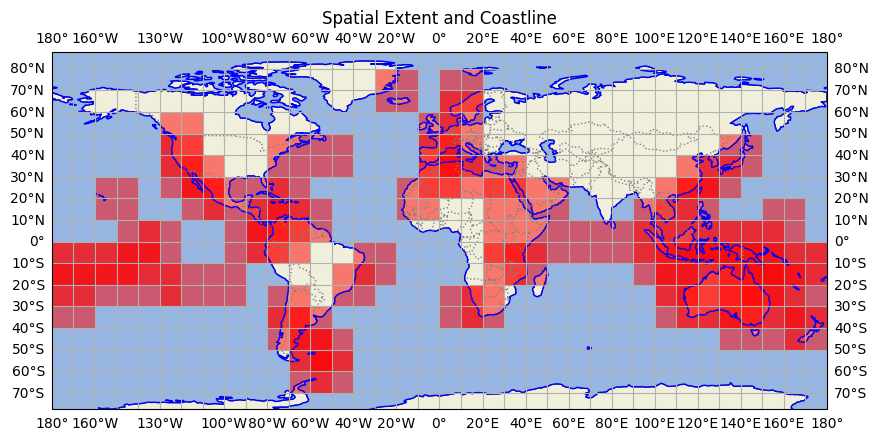

In [6]:
aodn_dataset.plot_spatial_extent()

## Get Temporal Extent of the dataset

Similary to the spatial extent, we're retrieving the minimum and maximum timestamp partition values of the dataset. This is not necessarely accurately representative of the TIME values, as the timestamp partition can be yearly/monthly... but is here to give an idea

In [7]:
%%time
aodn_dataset.get_temporal_extent()

CPU times: user 114 ms, sys: 48.9 ms, total: 163 ms
Wall time: 772 ms


(Timestamp('1992-03-10 00:00:00'), Timestamp('2025-09-15 15:00:00'))

## Read Metadata

For all Parquet datasets, we create a sidecar file named **_common_metadata** in the root of the dataset. This file contains both the dataset-level and variable-level attributes.  
The metadata can be retrieved below as a dictionary, and it will also be included in the pandas DataFrame when using the `get_data` method from the `GetAodn` class.

In [8]:
metadata = aodn_dataset.get_metadata()
metadata

2025-11-07 13:36:16,704 - aodn.GetAodn - INFO - Retrieving metadata for imos-data-lab-optimised/diver_reef_fish_abundance_biomass_qc.parquet


{'survey_id': {'type': 'int32'},
 'country': {'type': 'string'},
 'area': {'type': 'string'},
 'ecoregion': {'type': 'string'},
 'realm': {'type': 'string'},
 'location': {'type': 'string'},
 'site_code': {'type': 'string'},
 'site_name': {'type': 'string'},
 'latitude': {'type': 'double'},
 'longitude': {'type': 'double'},
 'survey_date': {'type': 'string',
  'standard_name': 'time',
  'long_name': 'Survey datetime (UTC)',
  'units': 's',
  'comments': 'Combined from survey_date and hour columns'},
 'depth': {'type': 'double'},
 'program': {'type': 'string'},
 'visibility': {'type': 'string'},
 'hour': {'type': 'string',
  'standard_name': 'time_of_day',
  'long_name': 'Time of day',
  'units': 'seconds since midnight'},
 'survey_latitude': {'type': 'double'},
 'survey_longitude': {'type': 'double'},
 'method': {'type': 'int32'},
 'block': {'type': 'int32'},
 'phylum': {'type': 'string'},
 'class_': {'type': 'string'},
 'order': {'type': 'string'},
 'family': {'type': 'string'},
 'spe

# Data Query and Plot

## Create a TIME and BoundingBox filter

This cell loads a subset of the dataset based on a time range and a spatial bounding box. The result is returned as a pandas DataFrame, and basic information about its structure is displayed.

In [9]:
%%time
df = aodn_dataset.get_data(date_start='2015-12-01', 
                           date_end='2019-01-01',
                           lat_min=-34, 
                           lat_max=-31, 
                           lon_min=151, 
                           lon_max=153,
                           lat_varname="latitude",
                           lon_varname="longitude",
                           )

df.info()

2025-11-07 13:36:17,442 - aodn.GetAodn - INFO - Retrieving metadata for imos-data-lab-optimised/diver_reef_fish_abundance_biomass_qc.parquet


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27587 entries, 0 to 27586
Data columns (total 33 columns):
 #   Column            Non-Null Count  Dtype         
---  ------            --------------  -----         
 0   survey_id         27587 non-null  int32         
 1   country           27587 non-null  object        
 2   area              27587 non-null  object        
 3   ecoregion         27587 non-null  object        
 4   realm             27587 non-null  object        
 5   location          27587 non-null  object        
 6   site_code         27587 non-null  object        
 7   site_name         27587 non-null  object        
 8   latitude          27587 non-null  float64       
 9   longitude         27587 non-null  float64       
 10  survey_date       27587 non-null  object        
 11  depth             27587 non-null  float64       
 12  program           27587 non-null  object        
 13  visibility        27491 non-null  object        
 14  hour              2741

In [10]:
df

,survey_id,country,area,ecoregion,realm,location,site_code,site_name,latitude,longitude,...,species_name,reporting_name,size_class,total,biomass,geom,filename,TIME,timestamp,polygon
0,912345923,Australia,New South Wales,Manning-Hawkesbury,Temperate Australasia,Port Stephens,PS13,Pipeline,-32.72,152.14,...,Filicampus tigris,Filicampus tigris,30.0,1,18.859840,0101000020E6100000000000E07A04634000000000295C...,ep_m1_public_data.csv,2015-12-24 00:00:00,1420070400,0103000000010000000500000000000000008061400000...
1,912345923,Australia,New South Wales,Manning-Hawkesbury,Temperate Australasia,Port Stephens,PS13,Pipeline,-32.72,152.14,...,Hippocampus whitei,Hippocampus whitei,10.0,1,7.718699,0101000020E6100000000000E07A04634000000000295C...,ep_m1_public_data.csv,2015-12-24 00:00:00,1420070400,0103000000010000000500000000000000008061400000...
2,912345923,Australia,New South Wales,Manning-Hawkesbury,Temperate Australasia,Port Stephens,PS13,Pipeline,-32.72,152.14,...,Brachaluteres jacksonianus,Brachaluteres jacksonianus,2.5,3,1.586043,0101000020E6100000000000E07A04634000000000295C...,ep_m1_public_data.csv,2015-12-24 00:00:00,1420070400,0103000000010000000500000000000000008061400000...
3,912345923,Australia,New South Wales,Manning-Hawkesbury,Temperate Australasia,Port Stephens,PS13,Pipeline,-32.72,152.14,...,Brachaluteres jacksonianus,Brachaluteres jacksonianus,5.0,15,60.019524,0101000020E6100000000000E07A04634000000000295C...,ep_m1_public_data.csv,2015-12-24 00:00:00,1420070400,0103000000010000000500000000000000008061400000...
4,912345923,Australia,New South Wales,Manning-Hawkesbury,Temperate Australasia,Port Stephens,PS13,Pipeline,-32.72,152.14,...,Eubalichthys mosaicus,Eubalichthys mosaicus,15.0,1,98.945343,0101000020E6100000000000E07A04634000000000295C...,ep_m1_public_data.csv,2015-12-24 00:00:00,1420070400,0103000000010000000500000000000000008061400000...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27582,912351299,Australia,New South Wales,Manning-Hawkesbury,Temperate Australasia,Port Stephens,PS13,Pipeline,-32.72,152.14,...,Ophthalmolepis lineolatus,Ophthalmolepis lineolatus,10.0,2,39.796829,0101000020E6100000000000E07A04634000000000295C...,ep_m1_public_data.csv,2018-11-25 10:00:00,1514764800,0103000000010000000500000000000000008061400000...
27583,912351299,Australia,New South Wales,Manning-Hawkesbury,Temperate Australasia,Port Stephens,PS13,Pipeline,-32.72,152.14,...,Notolabrus gymnogenis,Notolabrus gymnogenis,12.5,2,131.081802,0101000020E6100000000000E07A04634000000000295C...,ep_m1_public_data.csv,2018-11-25 10:00:00,1514764800,0103000000010000000500000000000000008061400000...
27584,912351299,Australia,New South Wales,Manning-Hawkesbury,Temperate Australasia,Port Stephens,PS13,Pipeline,-32.72,152.14,...,Notolabrus gymnogenis,Notolabrus gymnogenis,10.0,1,33.631905,0101000020E6100000000000E07A04634000000000295C...,ep_m1_public_data.csv,2018-11-25 10:00:00,1514764800,0103000000010000000500000000000000008061400000...
27585,912351299,Australia,New South Wales,Manning-Hawkesbury,Temperate Australasia,Port Stephens,PS13,Pipeline,-32.72,152.14,...,Notolabrus gymnogenis,Notolabrus gymnogenis,7.5,1,14.229336,0101000020E6100000000000E07A04634000000000295C...,ep_m1_public_data.csv,2018-11-25 10:00:00,1514764800,0103000000010000000500000000000000008061400000...


In [11]:
## Download Subsetted Data as CSV

# This cell downloads the filtered dataset as a ZIP-compressed CSV file.  
# The CSV includes metadata at the top as commented lines, and a `FileLink` object is returned to allow downloading directly from the notebook.


df.aodn.download_as_csv()

/home/lbesnard/github_repo/aodn_cloud_optimised/notebooks/aodn_metadata-uuid_b273fafa-03d6-4fc2-9acf-39d8c06581e5_diver_reef_fish_abundance_biomass_qc_data-hash_524a37b3.csv.zip

## Plot Species Abundance Over Time

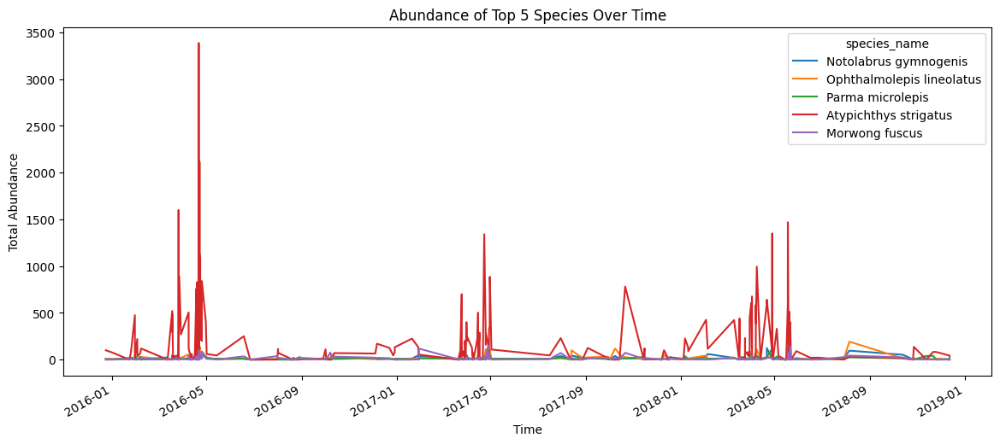

In [12]:
import matplotlib.pyplot as plt
import seaborn as sns

species_counts = df.groupby(['TIME', 'species_name'])['total'].sum().unstack(fill_value=0)

# Plot top 5 species
top_species = df['species_name'].value_counts().head(5).index
species_counts[top_species].plot(figsize=(14,6))
plt.title('Abundance of Top 5 Species Over Time')
plt.ylabel('Total Abundance')
plt.xlabel('Time')
plt.show()


## Plot Size / Biomass Distributions

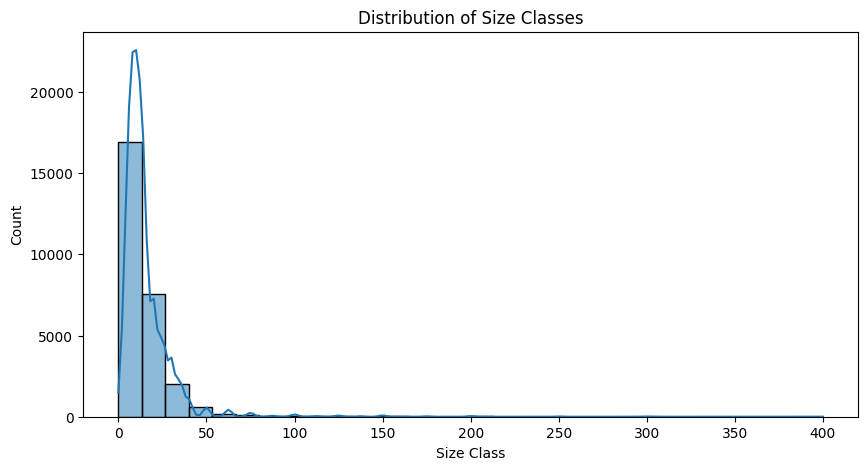

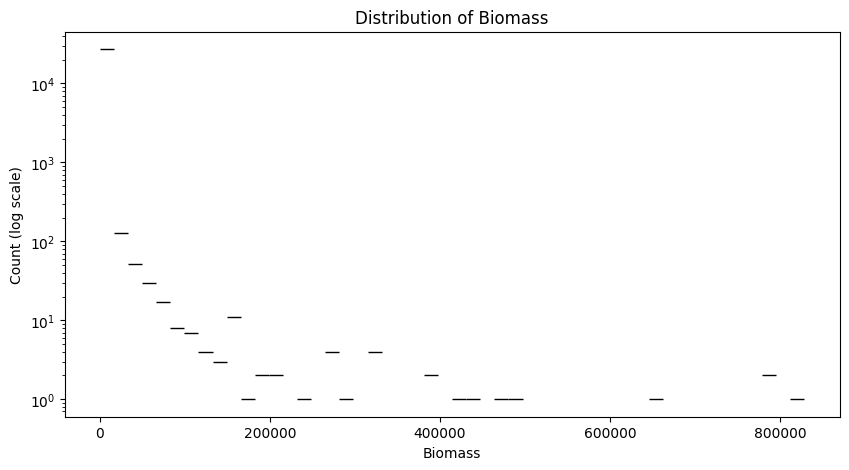

<Figure size 800x600 with 0 Axes>

<Figure size 800x600 with 0 Axes>

In [13]:
plt.figure(figsize=(10,5))
sns.histplot(df['size_class'], bins=30, kde=True)
plt.title('Distribution of Size Classes')
plt.xlabel('Size Class')
plt.ylabel('Count')
plt.show()

plt.figure(figsize=(10,5))
sns.histplot(df['biomass'], bins=50, log_scale=(False, True))
plt.title('Distribution of Biomass')
plt.xlabel('Biomass')
plt.ylabel('Count (log scale)')
plt.show()
plt.figure(figsize=(8,6))


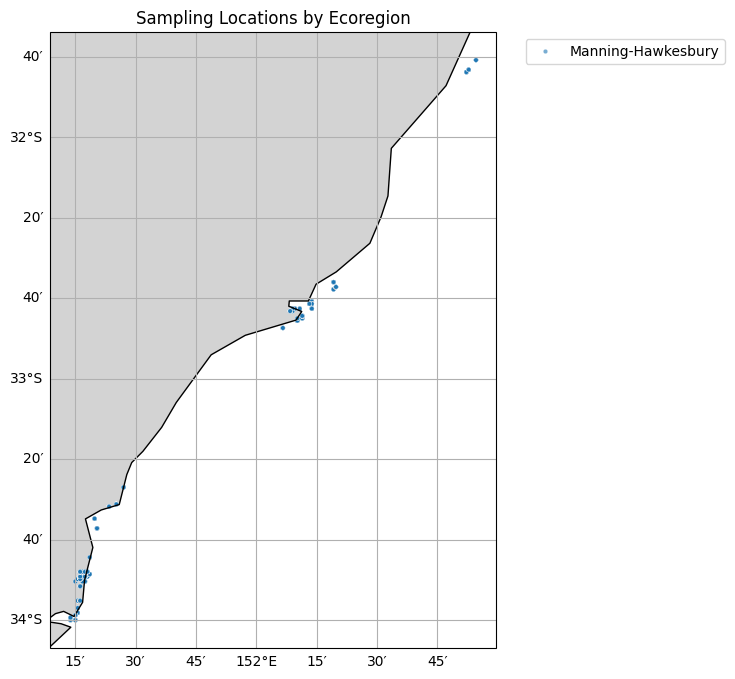

In [14]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import seaborn as sns
import numpy as np

# Projection
proj = ccrs.PlateCarree()

fig, ax = plt.subplots(figsize=(10,8), subplot_kw={"projection": proj})

# Add land and coastline
ax.add_feature(cfeature.LAND.with_scale('50m'), facecolor='lightgray')
ax.add_feature(cfeature.COASTLINE.with_scale('50m'))

# Scatter points
sns.scatterplot(
    x='longitude', y='latitude', hue='ecoregion', data=df,
    alpha=0.6, s=10, ax=ax, palette="tab10"
)

# Set title
ax.set_title("Sampling Locations by Ecoregion")
ax.set_xlabel("Longitude")
ax.set_ylabel("Latitude")

# Add gridlines with labels
gl = ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False)
gl.top_labels = False
gl.right_labels = False
gl.xlabel_style = {"size": 10}
gl.ylabel_style = {"size": 10}

# Adjust legend
ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left')

plt.show()


## Interactive Plot with Folium

In [15]:
import folium

m = folium.Map(location=[df['latitude'].mean(), df['longitude'].mean()], zoom_start=5)

for _, row in df.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=3,
        color='blue',
        fill=True,
        popup=f"{row['species_name']} ({row['total']})"
    ).add_to(m)

m
